In [1]:
# %%
import numpy as np
import scvelo as scv
import torch
from umap import UMAP
from sklearn.decomposition import PCA
from scipy.stats import mannwhitneyu
import matplotlib.pyplot as plt

from deepvelo.utils import (
    velocity,
    velocity_confidence,
    continuity_confidence,
    update_dict,
    cross_boundary_correctness,
)
from deepvelo.utils.preprocess import autoset_coeff_s
from deepvelo.utils.plot import statplot, compare_plot
from deepvelo import train, Constants


# fix random seeds for reproducibility
SEED = 123
torch.manual_seed(SEED)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False
np.random.seed(SEED)

scv.settings.verbosity = 3  # show errors(0), warnings(1), info(2), hints(3)
scv.settings.set_figure_params(
    "scvelo", transparent=False
)  # for beautified visualization
scv.settings.plot_prefix = ""

Using backend: pytorch


# Load Organogenesis data and preprocess

In [2]:
adata = scv.read("../data/cao_organogenesis_chondrocyte.h5ad", cache=True)
# sample to 30,000 cells
adata = adata[np.random.choice(adata.obs_names, 30000, replace=False)]
adata.X = adata.layers["spliced"] + adata.layers["unspliced"] + adata.layers["ambiguous"]
scv.pp.filter_and_normalize(adata, min_shared_counts=20, n_top_genes=2000)
scv.pp.moments(adata, n_neighbors=30, n_pcs=30)

# adata.obsm["X_umap"] = UMAP(n_components=2).fit_transform(adata.obsm["X_pca"])
adata.obsm["X_umap"] = adata.obsm["Main_trajectory_refined_umap"]


Filtered out 52271 genes that are detected 20 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 2000 highly variable genes.
computing neighbors
    finished (0:00:20) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:06) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [3]:
# Create obs cell_type column by copy Main_cell_type
adata.obs["cell_type"] = adata.obs["Main_cell_type"]
# remove cell_type "Cardiac muscle lineages" "Stromal cells" to None
adata.obs["cell_type"].replace("Cardiac muscle lineages", np.nan, inplace=True)
adata.obs["cell_type"].replace("Stromal cells", np.nan, inplace=True)

In [4]:
adata_raw = adata.copy()

# DeepVelo

In [5]:
# specific configs to overide the default configs
configs = {
    "name": "DeepVelo", # name of the experiment
    "loss": {"args": {"coeff_s": autoset_coeff_s(adata)}},
    "trainer": {"verbosity": 1}, # increase verbosity to show training progress
}
configs = update_dict(Constants.default_configs, configs)

The ratio of spliced reads is 26.4% (less than 70%). Suggest using coeff_s 0.5.


In [6]:
# initial velocity
# velocity(adata, mask_zero=False)
trainer = train(adata, configs)


building graph


INFO:train:Beginning training of DeepVelo ...


velo data shape: torch.Size([30000, 2000])


INFO:trainer:    epoch          : 1
INFO:trainer:    time:          : 2.055868625640869
INFO:trainer:    loss           : 80011.2890625
INFO:trainer:    mse            : 0.00041932836757041514
INFO:trainer:    epoch          : 2
INFO:trainer:    time:          : 0.5244367122650146
INFO:trainer:    loss           : 6951.26904296875
INFO:trainer:    mse            : 0.0004974678158760071
INFO:trainer:    epoch          : 3
INFO:trainer:    time:          : 0.5177066326141357
INFO:trainer:    loss           : 3833.05712890625
INFO:trainer:    mse            : 0.0006467509083449841
INFO:trainer:    epoch          : 4
INFO:trainer:    time:          : 0.5174870491027832
INFO:trainer:    loss           : 2684.052978515625
INFO:trainer:    mse            : 0.0008388570277020335
INFO:trainer:    epoch          : 5
INFO:trainer:    time:          : 0.5173606872558594
INFO:trainer:    loss           : 2122.11767578125
INFO:trainer:    mse            : 0.0010749174980446696
INFO:trainer:    epoch

confidence mse shape: (30000, 2000)
confidence mse stats: max 225.24224853515625, min 0.0, mean 0.007245013490319252, std 0.25944092869758606
confidence corr shape: (2000,)
confidence corr stats: max 0.8716244697570801, min -0.535496175289154, mean 0.6859877109527588, std 0.07738559693098068
velo_mat shape: (30000, 2000)
--> added 'velocity' (adata.layers)
--> added 'velocity_unspliced' (adata.layers)
--> added 'cell_specific_beta' (adata.layers)
--> added 'cell_specific_gamma' (adata.layers)


In [7]:
adata.var["velocity_genes"] = True  # use all genes for plotting
scv.tl.velocity_graph(adata, n_jobs=8)

computing velocity graph (using 8/8 cores)


  0%|          | 0/30000 [00:00<?, ?cells/s]

    finished (0:04:56) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


saving figure to file ./figures/cao_organo_chondrocyte_velocity_celltype.png


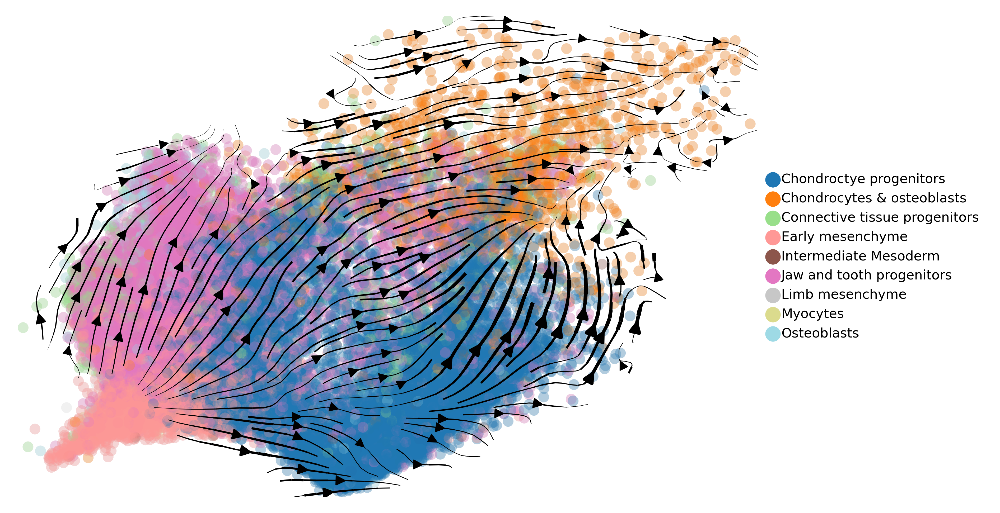

In [24]:
# velocity plot
scv.pl.velocity_embedding_stream(
    adata,
    basis="umap",
    color="cell_type",
    palette="tab20",
    legend_fontsize=6,
    legend_loc="right",
    title="",
    dpi=300,
    save="cao_organo_chondrocyte_velocity_celltype.png"
)


saving figure to file ./figures/cao_organo_chondrocyte_velocity_celltype_day.png


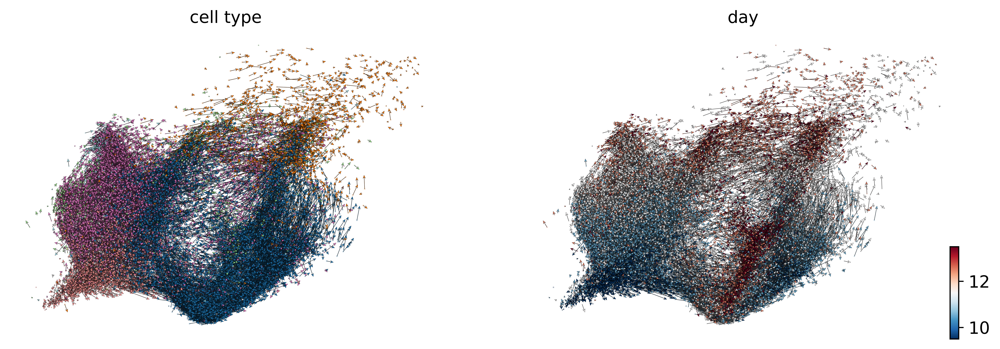

In [25]:
scv.pl.velocity_embedding(
    adata,
    basis="umap",
    color=["cell_type", "day"],
    arrow_length=6,
    arrow_size=1.2,
    dpi=300,
    save="cao_organo_chondrocyte_velocity_celltype_day.png"
)

In [26]:
# Do confidence analysis first to select reliable genes and velocities.
# Show the plots with these selected genes. Observable differences should appear 
# compared with previous plots with all genes.
# Continue on other analysis using the selected genes.

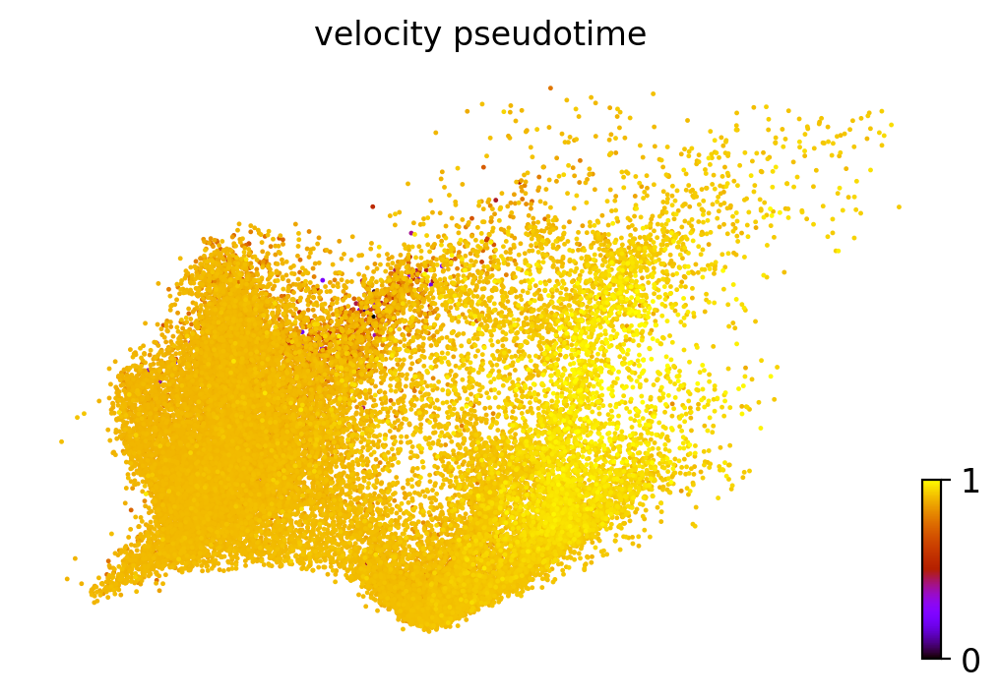

In [27]:
scv.tl.velocity_pseudotime(adata)
scv.pl.scatter(adata, color='velocity_pseudotime', color_map='gnuplot')

In [ ]:
scv.tl.velocity_clusters(adata, match_with="cell_type")
scv.pl.scatter(adata, color='velocity_clusters', legend_loc='right')

In [29]:
# compute velocity driving genes by ranking correlation between genes to velocity pseudo time

In [30]:
# save adata for next steps
deepvelo_adata = adata.copy()
# deepvelo_adata.write("saved/organogenesis/organogenesis_chondrocyte_velocity.h5ad")

# scVelo (dynamical)

In [31]:
adata = adata_raw.copy()

In [32]:
scv.tl.recover_dynamics(adata, n_jobs=8)
scv.tl.velocity(adata, mode="dynamical")


recovering dynamics (using 8/8 cores)


  0%|          | 0/95 [00:00<?, ?gene/s]

    finished (0:01:14) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing velocities
    finished (0:00:04) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)


In [33]:
scv.tl.velocity_graph(adata, n_jobs=8)


computing velocity graph (using 8/8 cores)


  0%|          | 0/30000 [00:00<?, ?cells/s]

    finished (0:03:04) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
    finished (0:00:12) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
saving figure to file ./figures/scvelo_cao_organo_chondrocyte_velocity_celltype.png


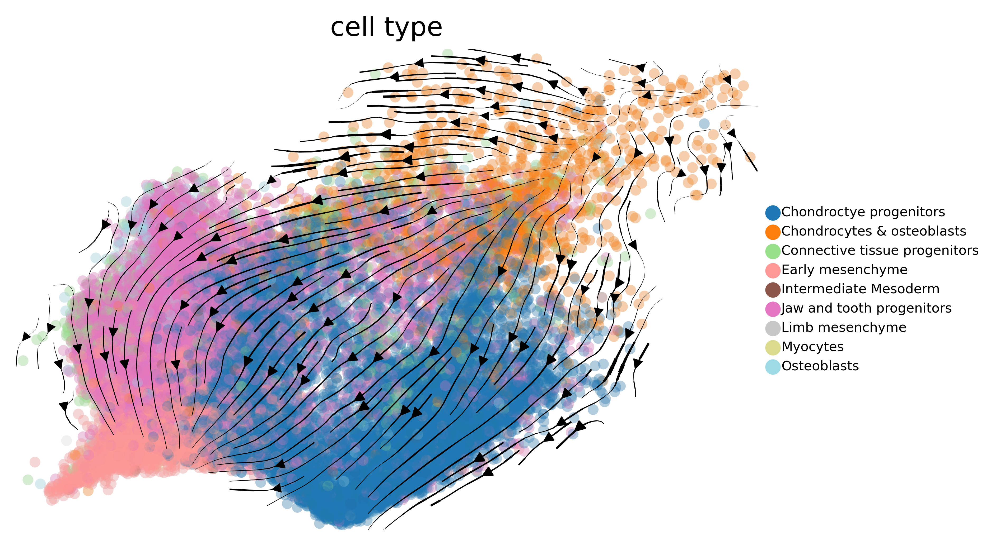

In [34]:
# velocity plot
scv.pl.velocity_embedding_stream(
    adata,
    basis="umap",
    color="cell_type",
    palette="tab20",
    legend_fontsize=6,
    legend_loc="right",
    dpi=300,
    save="scvelo_cao_organo_chondrocyte_velocity_celltype.png",
)

In [ ]:
# scv.pl.velocity_embedding(
#     adata,
#     basis="umap",
#     color="cell_type",
#     arrow_length=6,
#     arrow_size=1.2,
#     dpi=150,
# )

In [36]:
# scv.tl.velocity_confidence(adata, vkey='velocity')
# scv.pl.scatter(adata, color='velocity_confidence', perc=[2,98])
# scv.pl.scatter(adata, color='velocity_confidence_transition', perc=[2,98])

In [37]:
# save adata for next steps
dynamical_adata = adata.copy()

# Compare direction scores

In [38]:
cluster_edges = [
    ("Early mesenchyme", "Chondroctye progenitors"),
    ("Early mesenchyme", "Osteoblasts"),
    ("Early mesenchyme", "Intermediate Mesoderm"),
    ("Early mesenchyme", "Myocytes"),
    ("Early mesenchyme", "Connective tissue progenitors"),
    ("Early mesenchyme", "Limb mesenchyme"),
    ("Early mesenchyme", "Jaw and tooth progenitors"),
    ("Chondroctye progenitors", "Chondrocytes & osteoblasts")
]
cbcs, avg_cbc = cross_boundary_correctness(
    deepvelo_adata, "cell_type", "velocity", cluster_edges, return_raw=False, x_emb="X_umap"
)
print(f"Average cross-boundary correctness of DeepVelo: {avg_cbc:.2f}")
cbcs

Average cross-boundary correctness of DeepVelo: 0.23


{('Early mesenchyme', 'Chondroctye progenitors'): 0.5709762529689367,
 ('Early mesenchyme', 'Osteoblasts'): 0.05794298224246256,
 ('Early mesenchyme', 'Intermediate Mesoderm'): 0.23762101416018427,
 ('Early mesenchyme', 'Myocytes'): -0.11352652772977319,
 ('Early mesenchyme', 'Connective tissue progenitors'): 0.19534817961420756,
 ('Early mesenchyme', 'Limb mesenchyme'): 0.30828530603620413,
 ('Early mesenchyme', 'Jaw and tooth progenitors'): 0.24098408367314722,
 ('Chondroctye progenitors',
  'Chondrocytes & osteoblasts'): 0.35667013180304424}

In [39]:
cbcs, avg_cbc = cross_boundary_correctness(
    dynamical_adata, "cell_type", "velocity", cluster_edges, return_raw=False, x_emb="X_umap"
)
print(f"Average cross-boundary correctness of Dynamical: {avg_cbc:.2f}")
cbcs

Average cross-boundary correctness of Dynamical: 0.04


{('Early mesenchyme', 'Chondroctye progenitors'): 0.3274763850517108,
 ('Early mesenchyme', 'Osteoblasts'): -0.0891343337813525,
 ('Early mesenchyme', 'Intermediate Mesoderm'): 0.028980389460440438,
 ('Early mesenchyme', 'Myocytes'): 0.18102951184957983,
 ('Early mesenchyme', 'Connective tissue progenitors'): -0.1510236535016227,
 ('Early mesenchyme', 'Limb mesenchyme'): 0.1978730180979374,
 ('Early mesenchyme', 'Jaw and tooth progenitors'): 0.07466560440449431,
 ('Chondroctye progenitors',
  'Chondrocytes & osteoblasts'): -0.2801939126839395}

# Compare consistency score

--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence_cosine' (adata.obs)
--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence_cosine' (adata.obs)
DeepVelo mean score: 0.8867, std: 0.0369
Dynamical mean score: 0.7719, std: 0.0861


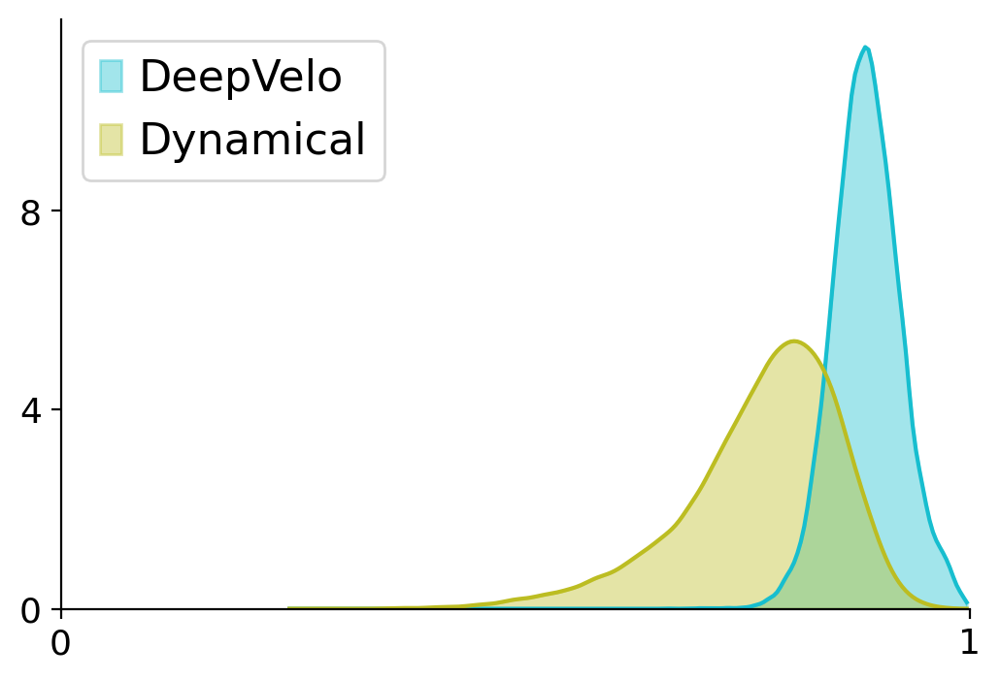

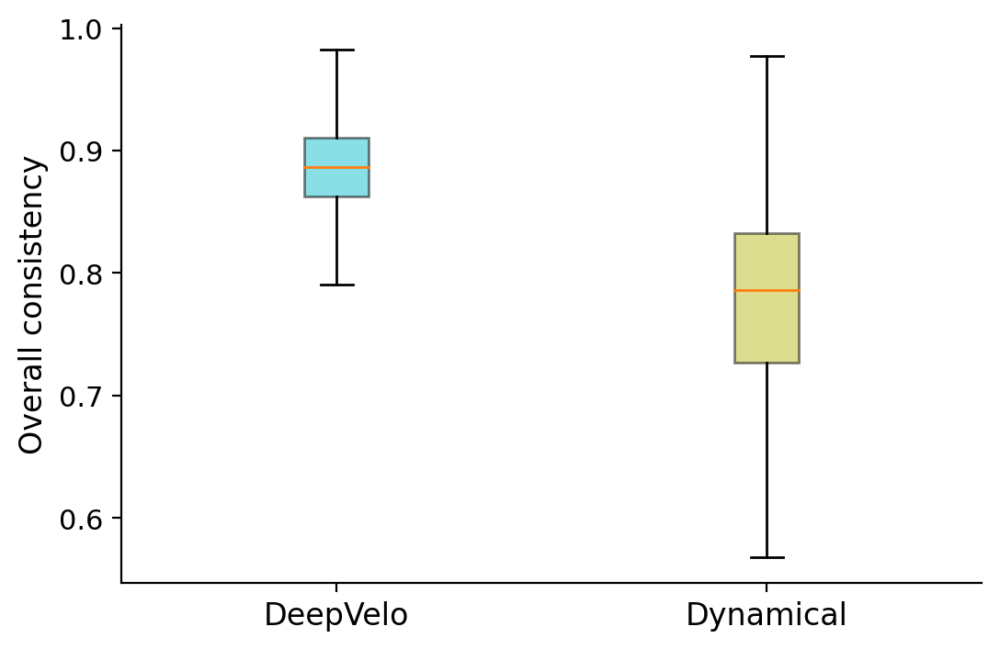

In [43]:
vkey = "velocity"
method = "cosine"
velocity_confidence(deepvelo_adata, vkey=vkey, method=method)
velocity_confidence(dynamical_adata, vkey=vkey, method=method)
ax_hist, ax_stat = compare_plot(deepvelo_adata, dynamical_adata, method=method)
ax_hist.get_figure().savefig(
    "dvelo_scvelo_overall_consistency_score_hist.pdf",
    dpi=300
)
ax_stat.get_figure().savefig(
    "dvelo_scvelo_overall_consistency_score_comp.pdf",
    dpi=300
)

In [41]:
# Mann-Whitney U Test test
stat, p = mannwhitneyu(
    deepvelo_adata.obs["velocity_confidence_cosine"].tolist(),
    dynamical_adata.obs["velocity_confidence_cosine"].tolist(),
)
print(f"Statistics {stat:.3f}, pvalue {p}")
# interpret
alpha = 0.05
if p > alpha:
    print("Same distribution (fail to reject H0)")
else:
    print("Different distribution (reject H0)")


Statistics 74981195.000, pvalue 0.0
Different distribution (reject H0)


--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence_cosine' (adata.obs)
--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence_cosine' (adata.obs)
DeepVelo mean score: 0.5900, std: 0.0765
Dynamical mean score: 0.4738, std: 0.1220


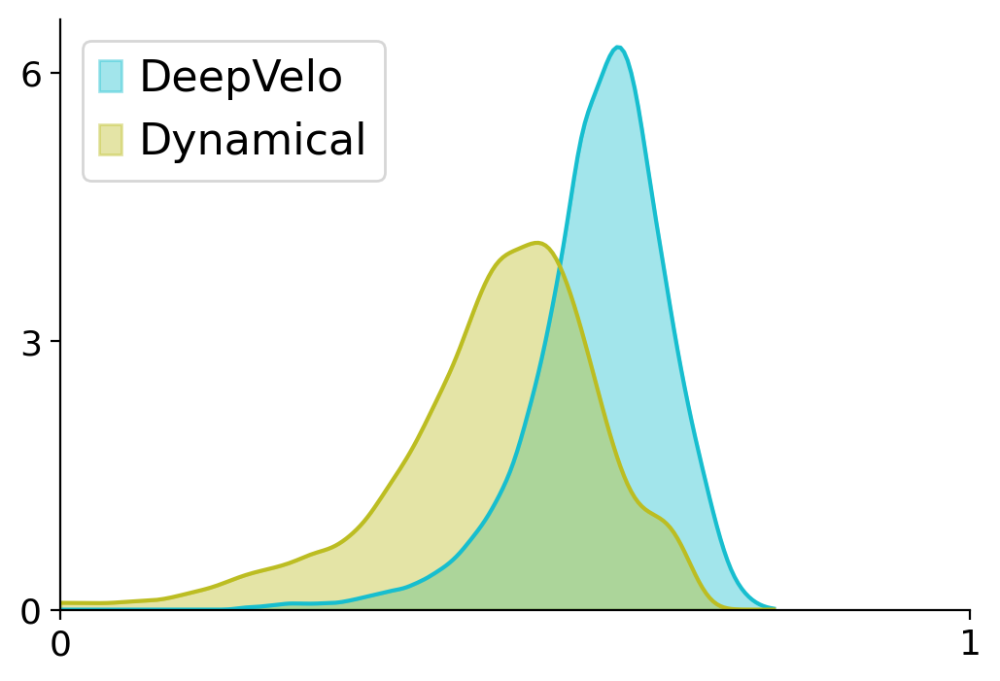

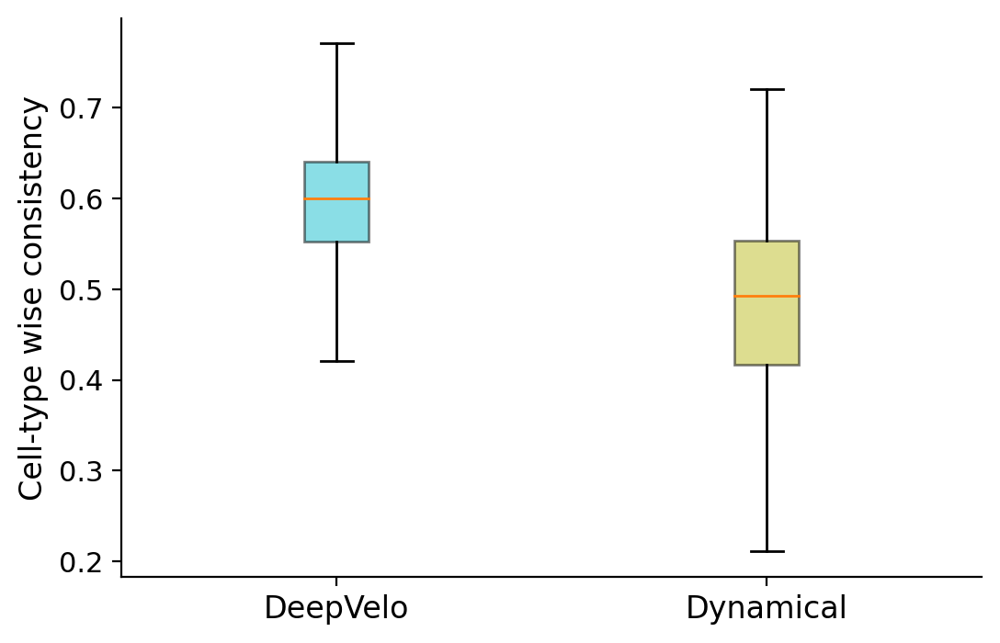

In [44]:
vkey = "velocity"
method = "cosine"
scope_key = "Main_cell_type"
# 3. cosine similarity, compute within Celltype
velocity_confidence(deepvelo_adata, vkey=vkey, method=method, scope_key=scope_key)
velocity_confidence(dynamical_adata, vkey=vkey, method=method, scope_key=scope_key)
ax_hist, ax_stat = compare_plot(deepvelo_adata, dynamical_adata, method=method, ylabel="Cell-type wise consistency")
ax_hist.get_figure().savefig(
    "dvelo_scvelo_celltype_consistency_score_hist.pdf",
    dpi=300
)
ax_stat.get_figure().savefig(
    "dvelo_scvelo_celltype_consistency_score_comp.pdf",
    dpi=300
)

In [45]:
# Mann-Whitney U Test test
stat, p = mannwhitneyu(
    deepvelo_adata.obs["velocity_confidence_cosine"].tolist(),
    dynamical_adata.obs["velocity_confidence_cosine"].tolist(),
)
print(f"Statistics {stat:.3f}, pvalue {p}")
# interpret
alpha = 0.05
if p > alpha:
    print("Same distribution (fail to reject H0)")
else:
    print("Different distribution (reject H0)")

Statistics 170859441.000, pvalue 0.0
Different distribution (reject H0)
